In [7]:
import os
from PIL import Image

data_dir = r'data\images'

invalid_images = []

for root, dirs, files in os.walk(data_dir):
    for file in files:
        file_path = os.path.join(root, file)
        try:
            # Mở và kiểm tra hình ảnh
            img = Image.open(file_path)
            img.verify()  # Kiểm tra tính hợp lệ của hình ảnh
        except (IOError, SyntaxError) as e:
            # Nếu có lỗi, thêm tệp không hợp lệ vào danh sách
            print('Invalid file:', file_path)
            invalid_images.append(file_path)

list_images = []
for root, dirs, files in os.walk(data_dir):
    dirs.sort()
    files.sort()
    for file in files:
        file_path = os.path.join(root, file)
        if file_path not in invalid_images:
            list_images.append(file_path)
# Số lượng ảnh trong tập dữ liệu
len(list_images)

10500

In [1]:
import numpy as np
import pandas as pd
from tensorflow.keras.preprocessing.image import DirectoryIterator
import os
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics.pairwise import cosine_similarity
from keras.applications.resnet50 import preprocess_input
from keras.preprocessing import image
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle

In [8]:
# Kích thước ảnh đầu vào 224x224
img_width, img_height = 224,224

# Khởi tạo mô hình ResNet50 và bỏ đi lớp fully connected (top layer)
model = ResNet50(weights='imagenet', include_top=False, input_shape=(img_width, img_height, 3))

In [6]:
# Trích xuất đặc trưng từ mô hình ResNet50
def extract_features(image_path):
    img = image.load_img(image_path, target_size=(img_width, img_height))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)
    features = model.predict(img_array, verbose=0)
    return features.flatten()

In [2]:
import mysql.connector

conn = mysql.connector.connect(
    host="localhost",
      user="root",
      password="",
      database="food_img_search"
    )
cursor = conn.cursor()

In [12]:
def get_feature_vectors():
    query = """SELECT id, feature FROM food_imgs"""
    cursor.execute(query)
    rows = cursor.fetchall()
    
    ids = []
    feature_vectors = []
    for row in rows:
        id = row[0]
        ids.append(id)
        feature_blob = row[1]
        feature_vector = pickle.loads(feature_blob)
        feature_vectors.append(np.array(feature_vector))
    
    return feature_vectors

In [13]:
vectors = get_feature_vectors()
X_train = np.array(vectors)

In [14]:
def display_query_img(path,ax):
    img = mpimg.imread(path)
    ax.imshow(img)
    ax.axis('off')
    ax.set_title('Query Image')

In [15]:
def search_similarity(query_img):
    # Trích xuất đặc trưng của ảnh mới
    query_image_feature = extract_features(query_img)

    x_test = [query_image_feature]

    # Tính toán cosine similarity giữa vector đặc trưng của hình ảnh mới và tất cả các hình ảnh trong X_train
    cos_similarities = cosine_similarity(x_test, X_train)

    # Sắp xếp hình ảnh các món ăn dựa trên cosine similarity
    sorted_indices = np.argsort(cos_similarities[0])[::-1]

    # Lấy danh sách các hình món ăn tương tự (10 hình món ăn tương tự đầu tiên)
    num_similar_items = 10
    similar_items = sorted_indices[:num_similar_items]
    
    fig,axes = plt.subplots(4, 5 , figsize=(15, 10))
    axes = axes.flatten()

    display_query_img(query_img, axes[2])
    for n in range(0,10):
        axes[n].axis('off')

    # Tạo subplot cho dòng chữ
    ax_text = fig.add_subplot(4, 5, (6, 10))
    ax_text.text(0.5, 0.5, '------------------------------- Similar Images -------------------------------',
                 ha='center', va='center', fontsize=14, color='black',
                 transform=ax_text.transAxes)
    ax_text.axis('off')

    
    # Show similar img
    for i, idx in enumerate(similar_items):
        image_path = list_images[idx]
        img = mpimg.imread(image_path)
        axes[i+10].imshow(img)
        axes[i+10].text(0.5, -0.1, image_path, ha='center', va='center', fontsize=10, color='black',
                 transform=axes[i+10].transAxes)
        axes[i+10].axis('off')

    for j in range(len(similar_items)+10, len(axes)):
        axes[j].axis('off')
    plt.tight_layout()
    plt.show()

In [16]:
import os
from PIL import Image

data_dir = r'test'

invalid = []

# Lặp qua tất cả các tệp trong thư mục dữ liệu
for root, dirs, files in os.walk(data_dir):
    for file in files:
        file_path = os.path.join(root, file)
        try:
            # Mở và kiểm tra hình ảnh
            img = Image.open(file_path)
            img.verify()  # Kiểm tra tính hợp lệ của hình ảnh
        except (IOError, SyntaxError) as e:
            # Nếu có lỗi, thêm tệp không hợp lệ vào danh sách
            print('Invalid file:', file_path)
            invalid.append(file_path)

list_test = []
for root, dirs, files in os.walk(data_dir):
    dirs.sort()
    files.sort()
    for file in files:
        file_path = os.path.join(root, file)
        if file_path not in invalid:
            list_test.append(file_path)

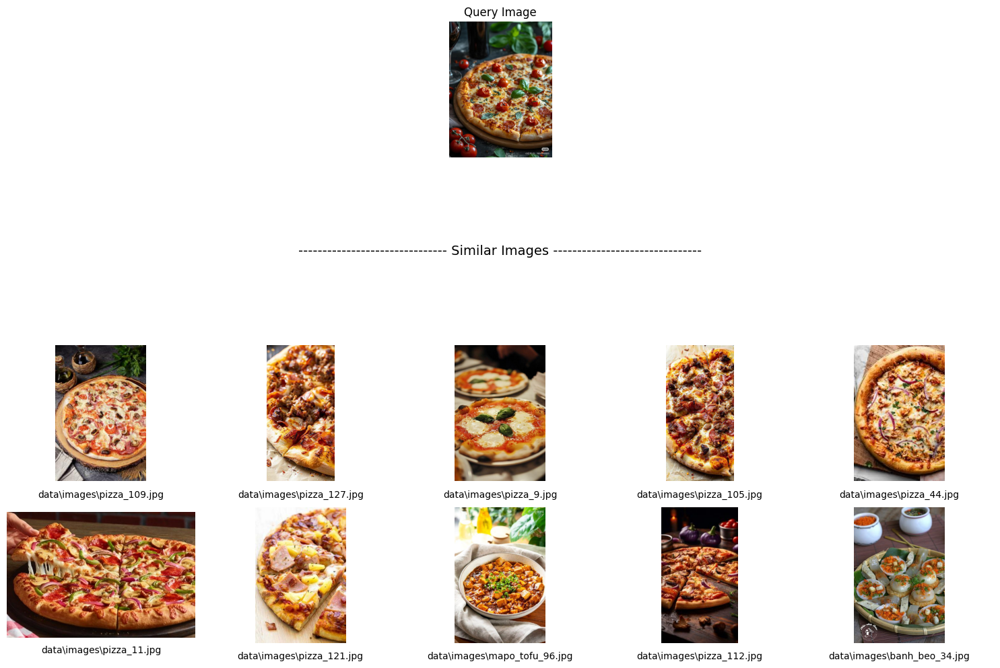

test\1.JPG: 18.56776714324951s


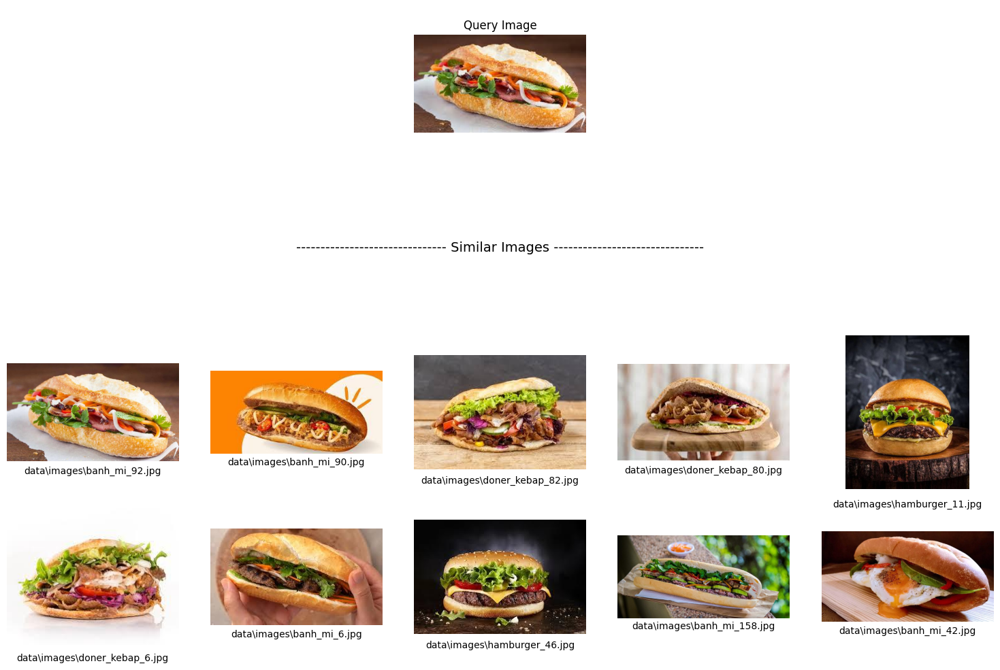

test\10.jpg: 7.379640340805054s


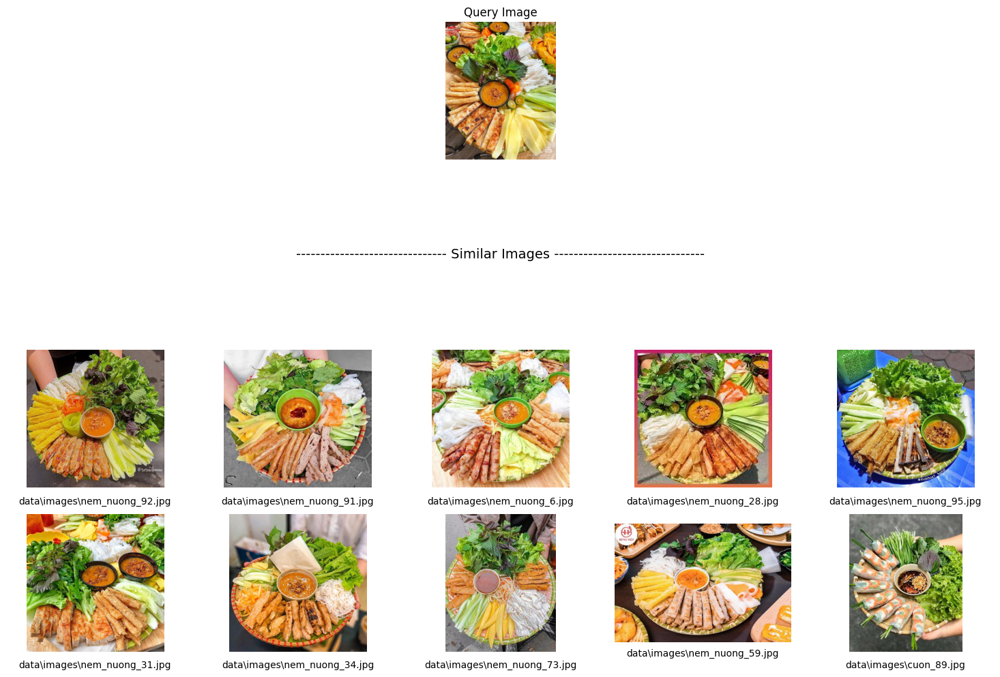

test\2.JPG: 4.278104543685913s


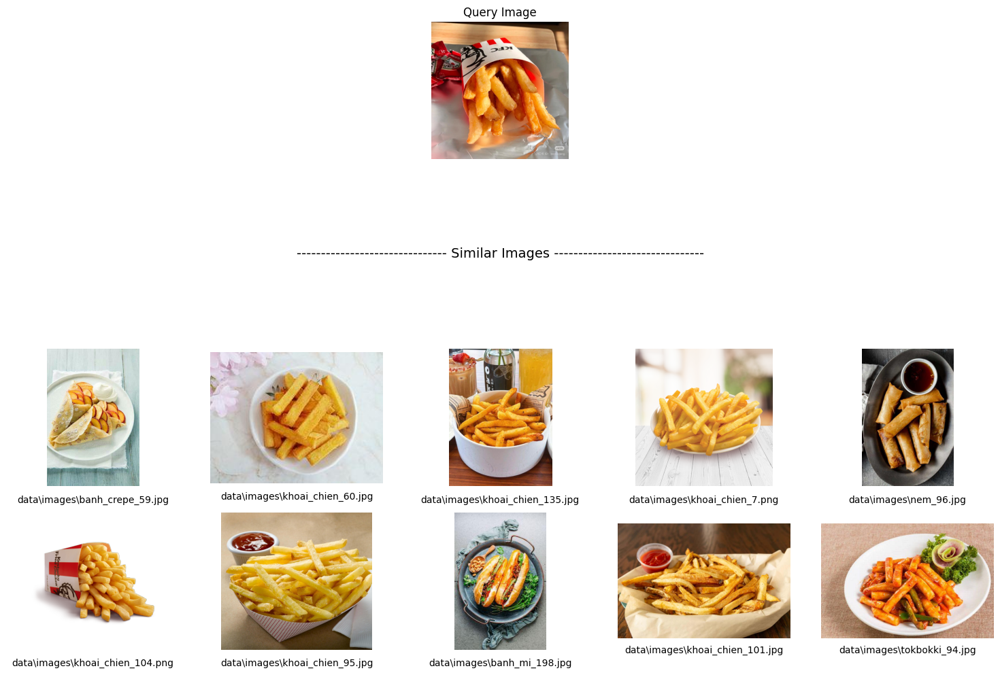

test\3.JPG: 4.021929979324341s


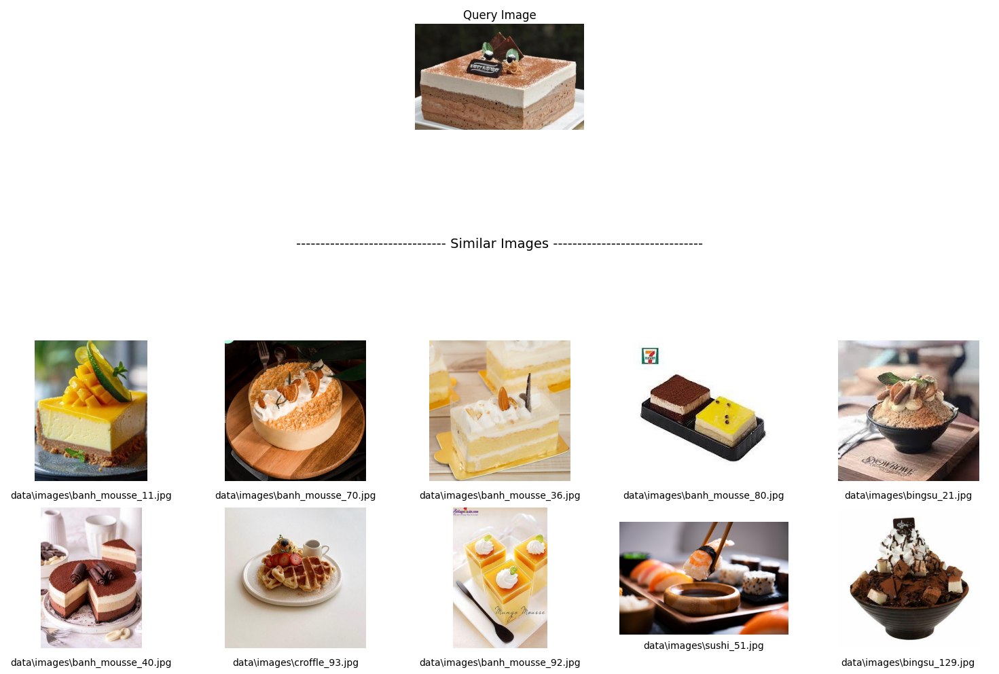

test\4.JPG: 4.089360952377319s


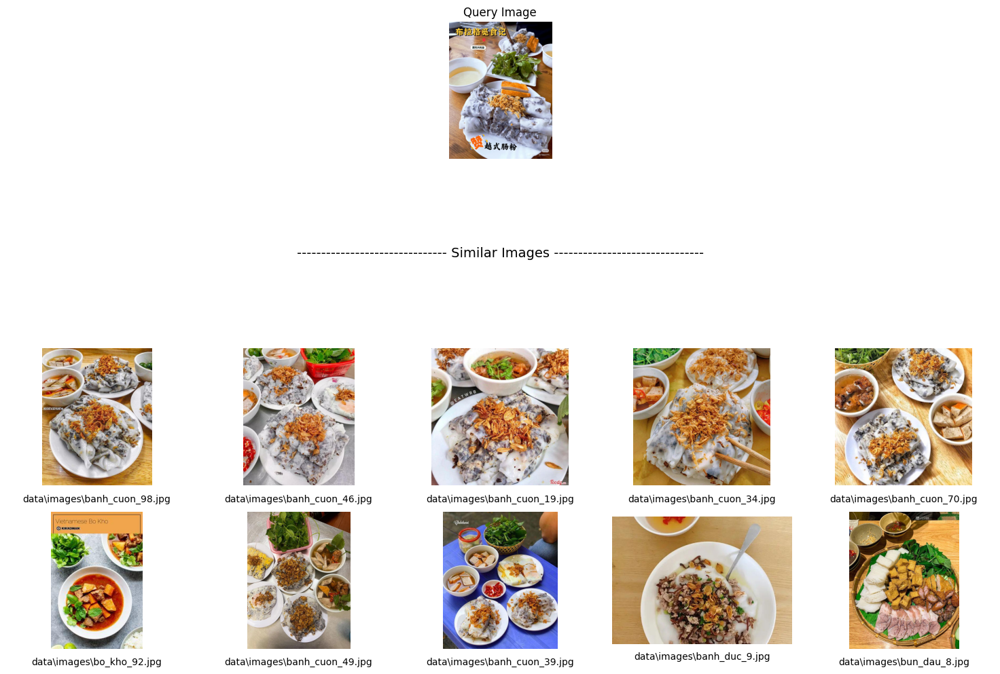

test\5.JPG: 4.095765590667725s


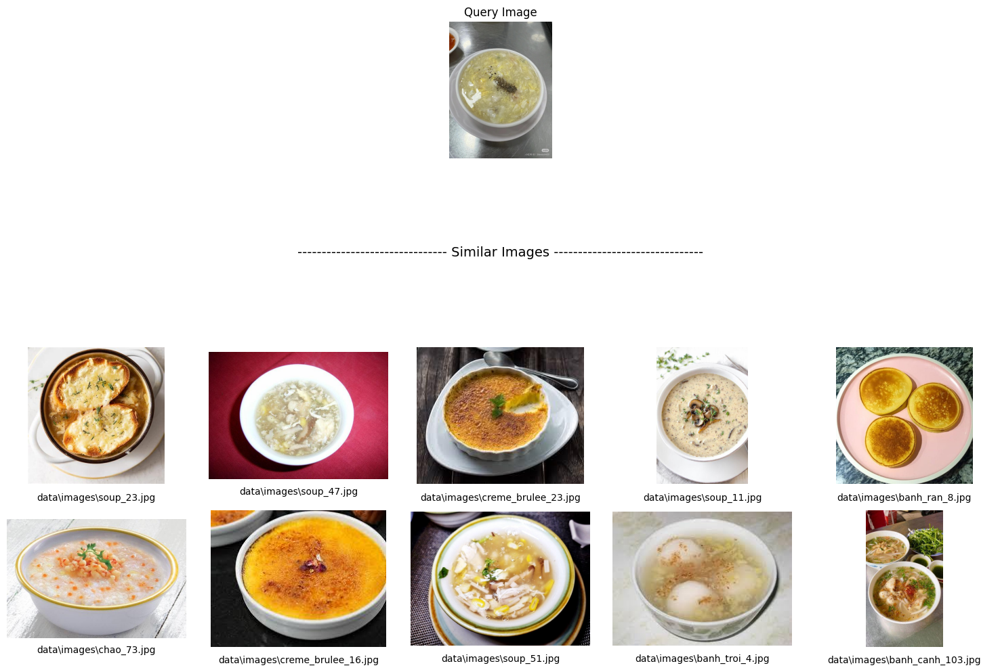

test\6.JPG: 3.865910768508911s


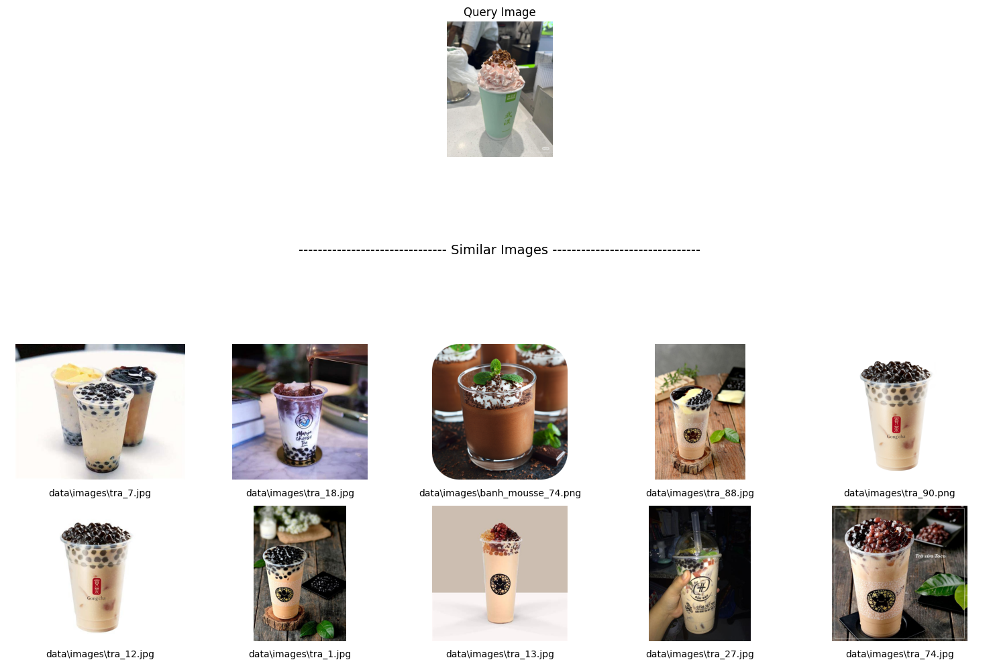

test\7.JPG: 4.249452590942383s


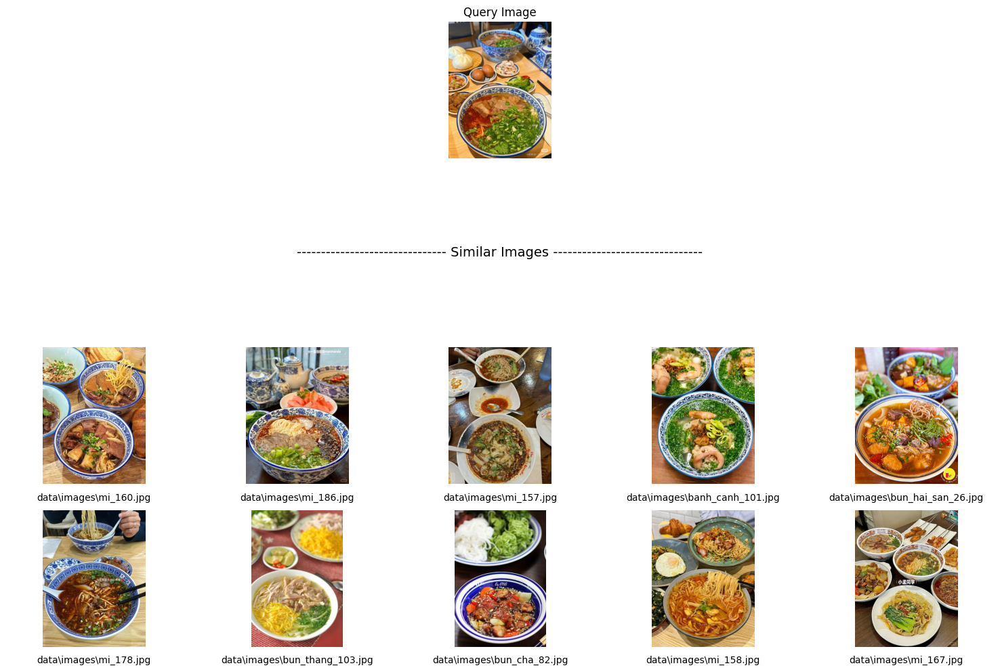

test\8.JPG: 7.973060131072998s


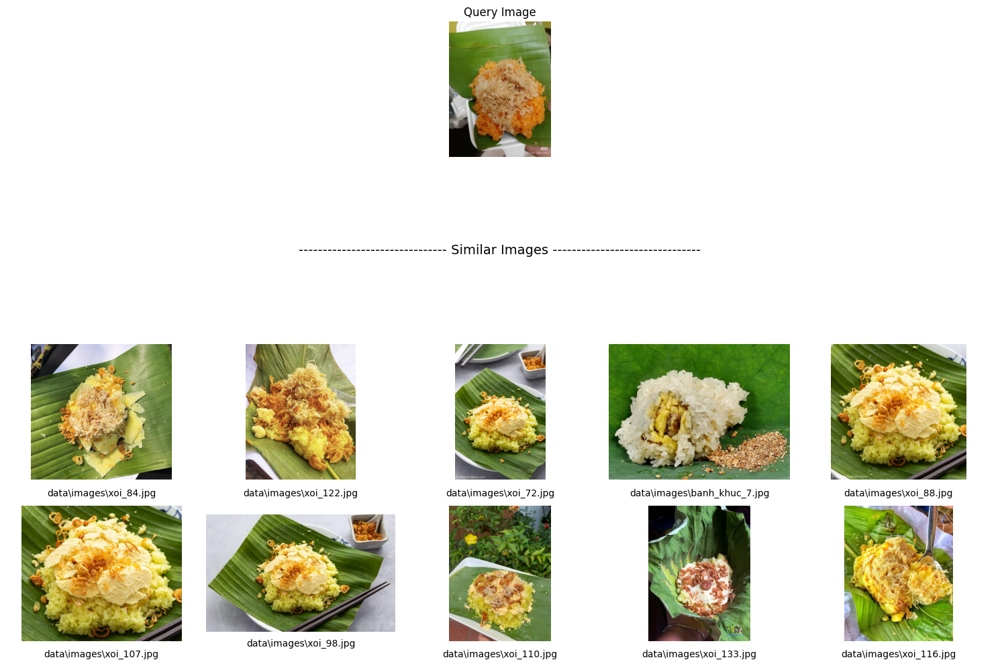

test\9.JPG: 6.3084752559661865s


In [17]:
import time

for test in list_test:
    start_time = time.time()  # Record the start time
    search_similarity(test)  # Perform the search
    end_time = time.time()  # Record the end time
    
    # Calculate the time taken and store it in the list
    elapsed_time = end_time - start_time
    
    print(test + ": " + str(elapsed_time) + "s")

In [18]:
import numpy as np

def average_precision(relevance_scores):
    """
    Tính Average Precision cho một truy vấn.
    relevance_scores: Danh sách điểm liên quan (1 cho liên quan, 0 cho không liên quan).
    """
    relevant_count = 0
    precision_sum = 0
    num_relevant_items = sum(relevance_scores)
    
    for i, relevance in enumerate(relevance_scores):
        if relevance == 1:
            relevant_count += 1
            precision_at_i = relevant_count / (i + 1)
            precision_sum += precision_at_i
    
    if num_relevant_items == 0:
        return 0  # Trường hợp không có hình ảnh liên quan nào
    return precision_sum / num_relevant_items

def mean_average_precision(queries_relevance_scores):
    """
    Tính Mean Average Precision (mAP) cho nhiều truy vấn.
    queries_relevance_scores: Danh sách của danh sách điểm liên quan cho từng truy vấn.
    """
    ap_sum = 0
    for relevance_scores in queries_relevance_scores:
        ap_sum += average_precision(relevance_scores)
    
    return ap_sum / len(queries_relevance_scores)

# Ví dụ với 10 truy vấn
queries_relevance_scores = [
    [1, 1, 1, 1, 1, 1, 1, 0, 1, 0],
    [1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
    [0, 1, 1, 1, 0, 1, 1, 0, 1, 0],
    [1, 1, 1, 1, 0, 1, 0, 1, 0, 0],
    [1, 1, 1, 1, 1, 0, 1, 1, 0, 0],
    [1, 1, 0, 1, 0, 1, 0, 1, 0, 0],
    [1, 1, 0, 1, 1, 1, 1, 1, 1, 1],
    [1, 1, 1, 0, 0, 1, 0, 0, 1, 1],
    [1, 1, 1, 0, 1, 1, 1, 1, 1, 1],
    [1, 1, 0, 0, 0, 0, 1, 0, 1, 1]
]

# Tính mAP
mAP = mean_average_precision(queries_relevance_scores)
print(f'mAP: {mAP:.4f}')

mAP: 0.8610


# Plot img and meta data

In [19]:
def get_food_info(img_path):
    conn = mysql.connector.connect(
    host="localhost",
      user="root",
      password="",
      database="food_img_search"
    )
    cursor = conn.cursor()
    cursor.execute(
        "SELECT food_name, description FROM food_imgs WHERE img_path = %s", (img_path,)
    )
    food_data = cursor.fetchone()
    if food_data:
        food_name, description = food_data
        return food_name, description
    else:
        return None, None

In [43]:
import textwrap

def plot_images_with_info(query_img_path):

    query_image_feature = extract_features(query_img_path)

    x_test = [query_image_feature]

    # Tính toán cosine similarity giữa vector đặc trưng của hình ảnh mới và tất cả các hình ảnh trong X_train
    cos_similarities = cosine_similarity(x_test, X_train)

    # Sắp xếp hình ảnh các món ăn dựa trên cosine similarity
    sorted_indices = np.argsort(cos_similarities[0])[::-1]

    # Lấy danh sách các hình món ăn tương tự (10 hình món ăn tương tự đầu tiên)
    num_similar_items = 10
    similar_images_data = sorted_indices[:num_similar_items]
    
    # Tạo biểu đồ với kích thước phù hợp
    fig, ax = plt.subplots(12, 2, figsize=(10, 6 * (num_similar_items + 1)))

    # Hiển thị ảnh truy vấn ở giữa
    query_img = plt.imread(query_img_path)
    ax[0, 0].imshow(query_img)
    ax[0, 0].set_title('Query image', fontsize=14)
    ax[0, 0].axis('off')
    ax[0, 1].axis('off')
    ax[1, 0].axis('off')
    ax[1, 0].text(0.5, 0.5, '---------------- Similar Images ----------------',
                 ha='center', va='center', fontsize=14, color='black',
                 transform=ax[1, 0].transAxes)
    ax[1, 1].axis('off')

    # Hiển thị các hình ảnh tương tự và thông tin của chúng
    for i, idx in enumerate(similar_images_data):
        image_path = list_images[idx] 
        img = plt.imread(image_path)
        ax[i+2, 0].imshow(img)
        ax[i+2, 0].axis('off')
        ax[i + 2, 0].text(0.5, -0.1, image_path, ha='center', va='center', fontsize=10, color='black',
                          transform=ax[i + 2, 0].transAxes)
        ax[i+2, 0].axis('off')

        # Lấy thông tin món ăn (tên và mô tả)
        name, description = get_food_info(image_path)
        if description is None:
            description = ""

        wrapped_description = textwrap.fill(description, width = 30)

        # Tạo chuỗi văn bản bao gồm tên và mô tả
        textstr = f"""
{name.title()}
                
{wrapped_description}"""

        # Hiển thị tên và mô tả, không có ô bọc
        ax[i+2, 1].text(0.5, 0.5, textstr, transform=ax[i+2, 1].transAxes, fontsize=12,
                        verticalalignment='center', horizontalalignment='left')
        ax[i+2, 1].axis('off')

    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

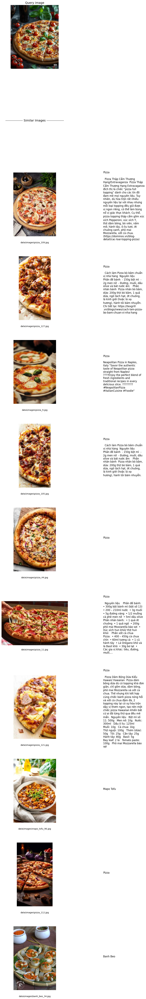

In [44]:
plot_images_with_info(r"test\1.JPG")

In [13]:
import textwrap

def get_db_connection():
    conn = mysql.connector.connect(
        host="localhost",
        user="root",
        password="",
        database="food_img_search"
    )
    return conn

def get_features():
    conn = get_db_connection()
    cursor = conn.cursor()
    query = """SELECT id, feature FROM food_imgs"""
    cursor.execute(query)
    rows = cursor.fetchall()
    
    ids = []
    feature_vectors = []
    for row in rows:
        id = row[0]
        ids.append(id)
        feature_blob = row[1]
        feature_vector = pickle.loads(feature_blob)
        feature_vectors.append(np.array(feature_vector))
    
    conn.close()
    return ids, feature_vectors

ids, train_features = get_features()
x_train = np.array(train_features)

def get_food_info(id):
    conn = get_db_connection()
    cursor = conn.cursor()
    query_select = """
    SELECT food_name, description, img_path FROM food_imgs
    WHERE id = %s
    """
    cursor.execute(query_select, (id,))
    food_data = cursor.fetchone()
    conn.close()
    
    if food_data:
        return food_data[0], food_data[1], food_data[2]
    else:
        return "", "", ""


In [15]:
def plot_images_with_info(query_img_path):

    query_image_feature = extract_features(query_img_path)

    x_test = [query_image_feature]

    # Tính toán cosine similarity giữa vector đặc trưng của hình ảnh mới và tất cả các hình ảnh trong X_train
    cos_similarities = cosine_similarity(x_test, x_train)

    # Sắp xếp hình ảnh các món ăn dựa trên cosine similarity
    sorted_indices = np.argsort(cos_similarities[0])[::-1]

    # Lấy danh sách các hình món ăn tương tự (10 hình món ăn tương tự đầu tiên)
    num_similar_items = 10
    similar_images_data = sorted_indices[:num_similar_items]
    
    # Tạo biểu đồ với kích thước phù hợp
    fig, ax = plt.subplots(12, 2, figsize=(10, 6 * (num_similar_items + 1)))

    # Hiển thị ảnh truy vấn ở giữa
    query_img = plt.imread(query_img_path)
    ax[0, 0].imshow(query_img)
    ax[0, 0].set_title('Query image', fontsize=14)
    ax[0, 0].axis('off')
    ax[0, 1].axis('off')
    ax[1, 0].axis('off')
    ax[1, 0].text(0.5, 0.5, '---------------- Similar Images ----------------',
                 ha='center', va='center', fontsize=14, color='black',
                 transform=ax[1, 0].transAxes)
    ax[1, 1].axis('off')

    list_image_urls = []
    list_food_names = []
    descriptions = []
    list_images = []

    # Hiển thị các hình ảnh tương tự và thông tin của chúng
    for i, idx in enumerate(similar_images_data):
        food_id = ids[idx]
        food_name, description, image_path = get_food_info(food_id)

        if food_name and description and image_path:
            list_food_names.append(food_name.title())
            descriptions.append(description)
            list_images.append(image_path)
            
        img = plt.imread(image_path)
        ax[i+2, 0].imshow(img)
        ax[i+2, 0].axis('off')
        ax[i + 2, 0].text(0.5, -0.1, image_path, ha='center', va='center', fontsize=10, color='black',
                          transform=ax[i + 2, 0].transAxes)
        ax[i+2, 0].axis('off')

        if description is None:
            description = ""

        wrapped_description = textwrap.fill(description, width = 30)

        # Tạo chuỗi văn bản bao gồm tên và mô tả
        textstr = f"""
{food_name.title()}
                
{wrapped_description}"""

        # Hiển thị tên và mô tả, không có ô bọc
        ax[i+2, 1].text(0.5, 0.5, textstr, transform=ax[i+2, 1].transAxes, fontsize=12,
                        verticalalignment='center', horizontalalignment='left')
        ax[i+2, 1].axis('off')

    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

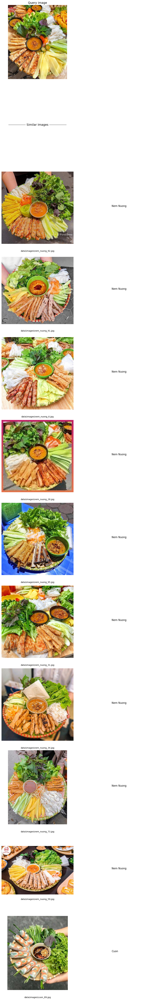

In [16]:
plot_images_with_info(r'test\2.JPG')